# dataset 설명
### Column
image_name, clothes_type, variation_type, (뭔지 모르겠음)<br>
8개의 랜드마크 좌표에 대한 visibility(가려져 있느냐 보이느냐), x좌표, y좌표<br>
총 27개의 column

In [55]:
import pandas as pd

df = pd.read_table('dataset/Fashion Landmark Detection Benchmark/Anno/list_landmarks_1000.txt', sep=' ')
#df.fillna(Na, inplace=True)
df.head()

,image_name,clothes_type,variation_type,landmark_visibility_1,landmark_location_x_1,landmark_location_y_1,landmark_visibility_2,landmark_location_x_2,landmark_location_y_2,landmark_visibility_3,...,landmark_location_y_5,landmark_visibility_6,landmark_location_x_6,landmark_location_y_6,landmark_visibility_7,landmark_location_x_7,landmark_location_y_7,landmark_visibility_8,landmark_location_x_8,landmark_location_y_8
0,img/img_00000001.jpg,1,1,1,144,156,1,221,159,0,...,408.0,0.0,237.0,412.0,NaN,NaN,NaN,NaN,NaN,NaN
1,img/img_00000002.jpg,1,3,0,111,104,1,153,105,0,...,188.0,1.0,137.0,198.0,NaN,NaN,NaN,NaN,NaN,NaN
2,img/img_00000003.jpg,1,1,0,112,113,1,172,117,0,...,277.0,1.0,187.0,262.0,NaN,NaN,NaN,NaN,NaN,NaN
3,img/img_00000004.jpg,1,2,0,76,74,0,108,69,0,...,174.0,0.0,126.0,170.0,NaN,NaN,NaN,NaN,NaN,NaN
4,img/img_00000005.jpg,1,1,0,217,139,0,290,156,0,...,314.0,0.0,309.0,313.0,NaN,NaN,NaN,NaN,NaN,NaN


In [44]:
df.iloc[0]

image_name               img/img_00000001.jpg
clothes_type                                1
variation_type                              1
landmark_visibility_1                       1
landmark_location_x_1                     144
landmark_location_y_1                     156
landmark_visibility_2                       1
landmark_location_x_2                     221
landmark_location_y_2                     159
landmark_visibility_3                       0
landmark_location_x_3                      86
landmark_location_y_3                     218
landmark_visibility_4                       1
landmark_location_x_4                     250
landmark_location_y_4                     238
landmark_visibility_5                       0
landmark_location_x_5                     111
landmark_location_y_5                     408
landmark_visibility_6                       0
landmark_location_x_6                     237
landmark_location_y_6                     412
landmark_visibility_7             

In [56]:
coord = np.array(df.iloc[0])
x_index = [4+3*x for x in range(8)]
y_index = [5+3*x for x in range(8)]
co_x = coord[x_index]
co_y = coord[y_index]
print(co_x)
print(co_y)

[144 221 86 250 111.0 237.0 nan nan]
[156 159 218 238 408.0 412.0 nan nan]


(512, 349, 3)


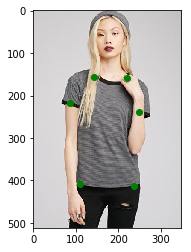

In [58]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

img = mpimg.imread('dataset/img/img_00000001.jpg')
imgplot = plt.imshow(img)
plt.scatter(co_x, co_y,
           marker = 'o',
          color = 'green')
print(np.shape(img))

In [62]:
df = pd.read_table('dataset/Fashion Landmark Detection Benchmark/Anno/list_bbox_1000.txt', sep=' ')
coord = np.array(df.iloc[0])
x_index = [1,3]
y_index = [2,4]
co_x = coord[x_index]
co_y = coord[y_index]
print(co_x)
print(co_y)

[53 289]
[130 440]


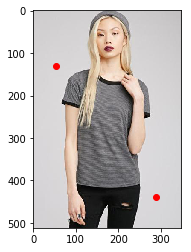

In [63]:
img = mpimg.imread('dataset/img/img_00000001.jpg')
imgplot = plt.imshow(img)
plt.scatter(co_x, co_y, label = 'y = x^2', 
           marker = 'o',
          color = 'red')

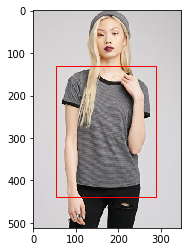

In [66]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np

im = np.array(Image.open('dataset/img/img_00000001.jpg'), dtype=np.uint8)

# Create figure and axes
fig,ax = plt.subplots(1)

# Display the image
ax.imshow(im)

# Create a Rectangle patch
w = co_x[1]-co_x[0]
h = co_y[1]-co_y[0]
rect = patches.Rectangle((co_x[0],co_y[0]), w, h, linewidth=1,edgecolor='r',facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)

plt.show()

# DeepFashion1 landmark is too sparse
so I downloaded deepfashion2 dataset.<br>
Here is one of annotation(**DeepFashion2\validation\validation\annos\000002.json**) landmark and visualize<br>
괜히 영어로 한 번 써봤는데(ㅋㅋ)<br>deepfashion1 데이터셋의 랜드마크 8개가 너무 듬성듬성해서<br>
이걸 기반으로 세그먼테이션 하기는 좀 어려울것 같아서<br>
랜드마크가 좀더 촘촘한 deepfashion2를 가지고 시각화 해보겠다는 소립니다.<br>
## DeepFashion2의 랜드마크
![](https://github.com/switchablenorms/DeepFashion2/raw/master/images/annotation.jpg)


In [75]:
landmark1 = np.array([218, 124, 1, 195, 123, 1, 205, 130, 1, 219, 132, 2, 236, 126, 1, 248, 122, 1, 175, 139, 2, 180, 165, 1, 188, 190, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 265, 183, 2, 271, 159, 2, 276, 131, 2])
# "style": 1, "bounding_box": [170, 121, 280, 215], "category_id": 5, "occlusion": 2, "category_name": "vest"
landmark2 = np.array([235, 203, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 182, 133, 1, 0, 0, 0, 0, 0, 0, 196, 218, 2, 193, 302, 2, 202, 378, 2, 246, 379, 2, 290, 371, 2, 281, 280, 2, 263, 206, 2, 0, 0, 0, 0, 0, 0, 253, 121, 1])

In [76]:
x_idx1 = [x*3 for x in range(len(landmark1)//3)]
y_idx1 = [1+x*3 for x in range(len(landmark1)//3)]
coord_x1 = landmark1[x_idx1]
coord_y1 = landmark1[y_idx1]


x_idx2 = [x*3 for x in range(len(landmark2)//3)]
y_idx2 = [1+x*3 for x in range(len(landmark2)//3)]
coord_x2 = landmark2[x_idx2]
coord_y2 = landmark2[y_idx2]

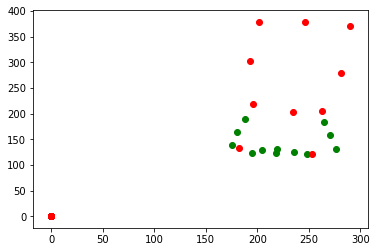

In [77]:
# Create figure and axes
fig,ax = plt.subplots(1)
ax.scatter(coord_x1, coord_y1, 
           marker = 'o',
          color = 'green')
ax.scatter(coord_x2, coord_y2, 
           marker = 'o',
          color = 'red')

### looks like a sleeveless t-shirt and short pants.

In [80]:
import json
from collections import OrderedDict

def get_json(filename):
    with open(filename, mode='r') as f:
        json_data = json.load(f, object_pairs_hook=OrderedDict)
    return json_data

anno = get_json('dataset/DeepFashion2/validation/validation/annos/000002.json')
print(json.dumps(anno, indent=4, sort_keys=True)) # print with indent (pretty!)

{
    "item1": {
        "bounding_box": [
            170,
            121,
            280,
            215
        ],
        "category_id": 5,
        "category_name": "vest",
        "landmarks": [
            218,
            124,
            1,
            195,
            123,
            1,
            205,
            130,
            1,
            219,
            132,
            2,
            236,
            126,
            1,
            248,
            122,
            1,
            175,
            139,
            2,
            180,
            165,
            1,
            188,
            190,
            2,
            0,
            0,
            0,
            0,
            0,
            0,
            0,
            0,
            0,
            265,
            183,
            2,
            271,
            159,
            2,
            276,
            131,
            2
        ],
        "occlusion": 2,
        "scale": 1,
        "segmentatio

In [96]:
seg1 = np.array(anno["item1"]["segmentation"][0])
seg = np.array(anno["item2"]["segmentation"][0])

앗 이게 뭐지


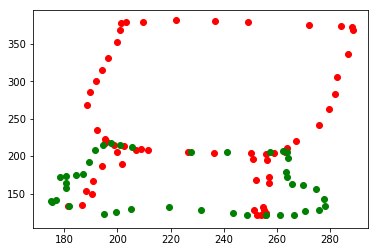

In [98]:
x_idx_seg = [x*2 for x in range(len(seg)//2)]
y_idx_seg = [x*2+1 for x in range(len(seg)//2)]
coord_x_seg = seg[x_idx_seg]
coord_y_seg = seg[y_idx_seg]


seg1 = np.array(anno["item1"]["segmentation"][0])
x_idx_seg1 = [x*2 for x in range(len(seg1)//2)]
y_idx_seg1 = [x*2+1 for x in range(len(seg1)//2)]
coord_x_seg1 = seg1[x_idx_seg1]
coord_y_seg1 = seg1[y_idx_seg1]


# Create figure and axes
fig,ax = plt.subplots(1)
ax.scatter(coord_x_seg, coord_y_seg, 
           marker = 'o',
          color = 'red')

ax.scatter(coord_x_seg1, coord_y_seg1, 
           marker = 'o',
          color = 'green')
print('앗 이게 뭐지')

In [100]:
512/4
349/4

87.25

In [4]:
import json
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
json_file = "C:/Users/chief/[2]FittingroomAnywhere2/Mask_RCNN/datasets/Tshirt_dataset/all_annos/000234.json"
img_file = im_dir = 'C:/Users/chief/[2]FittingroomAnywhere2/Mask_RCNN/datasets/Tshirt_dataset/val/img/000234.jpg'
# images 파일명이 있는 json 파일 읽어들이기
with open(json_file) as json_file:
    json_data = json.load(json_file)

In [5]:
segmentation = json_data["item1"]["segmentation"][0]
hl = len(segmentation)//2
sx = [segmentation[x*2] for x in range(hl)]
sy = [segmentation[x*2+1] for x in range(hl)]

landmarks = json_data["item1"]["landmarks"]
hl = len(landmarks)//3
lx = [landmarks[x*3] for x in range(hl)]
ly = [landmarks[x*3+1] for x in range(hl)]

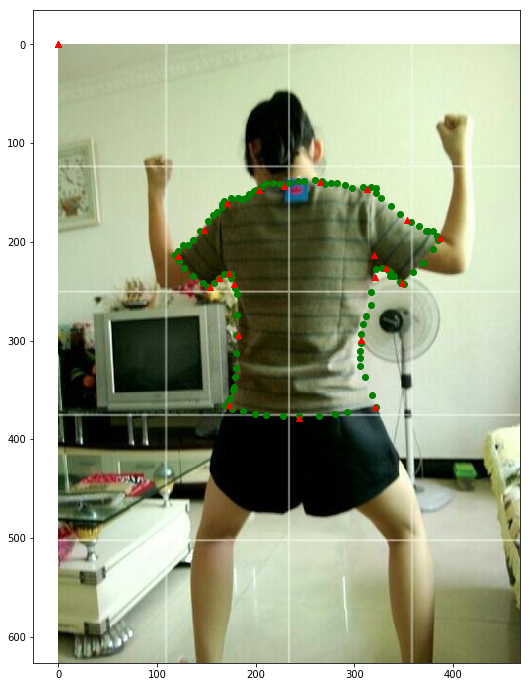

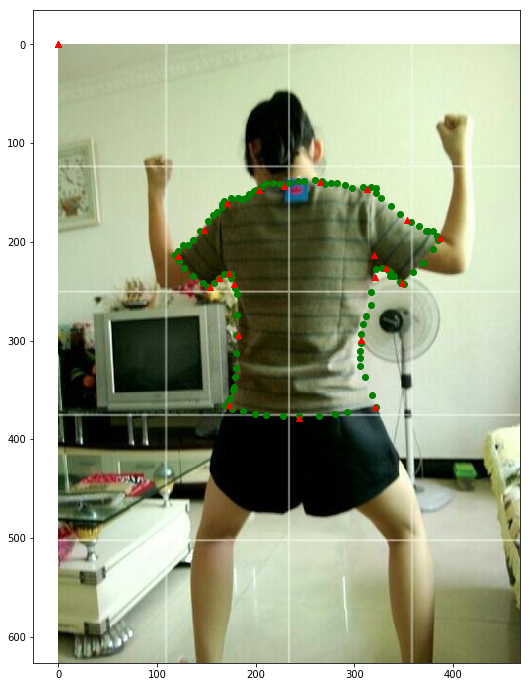

In [11]:
img = mpimg.imread(img_file)
for i in range(2):
    # change the figure size
    fig2 = plt.figure(figsize = (12,12)) # create a 5 x 5 figure 
    ax3 = fig2.add_subplot(111)
    ax3.imshow(img, interpolation='none')
    plt.scatter(sx, sy,
               marker = 'o',
              color = 'green')

    plt.scatter(lx, ly,
               marker = '^',
              color = 'red')

    plt.show()

In [24]:
# Create figure and axes
fig,ax = plt.subplots(1)
ax.scatter(x, y, 
           marker = 'o',
          color = 'red')
fig.show()


(667, 750, 3)


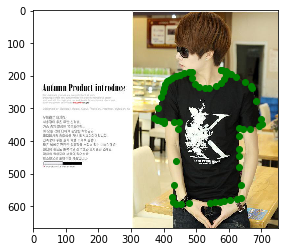

In [13]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import os
import json

im_dir = 'C:/Users/chief/[2]FittingroomAnywhere2/Mask_RCNN/datasets/Tshirt_dataset/train/img/'
img_name = os.listdir(im_dir)
json_dir = 'C:/Users/chief/[2]FittingroomAnywhere2/Mask_RCNN/datasets/Tshirt_dataset/train/anno/'
json_name = [x.replace(".jpg", ".json") for x in img_name]

# json 파일 열기
with open(json_dir+json_name[1]) as json_file:
    json_data = json.load(json_file)
# segmentation 좌표
segmentation = json_data["item1"]["segmentation"][0]
hl = len(segmentation)//2
x = [segmentation[x*2] for x in range(hl)]
y = [segmentation[x*2+1] for x in range(hl)]
    
img = mpimg.imread(im_dir+img_name[1])
imgplot = plt.imshow(img)
plt.scatter(x, y,
           marker = 'o',
          color = 'green')
print(np.shape(img))

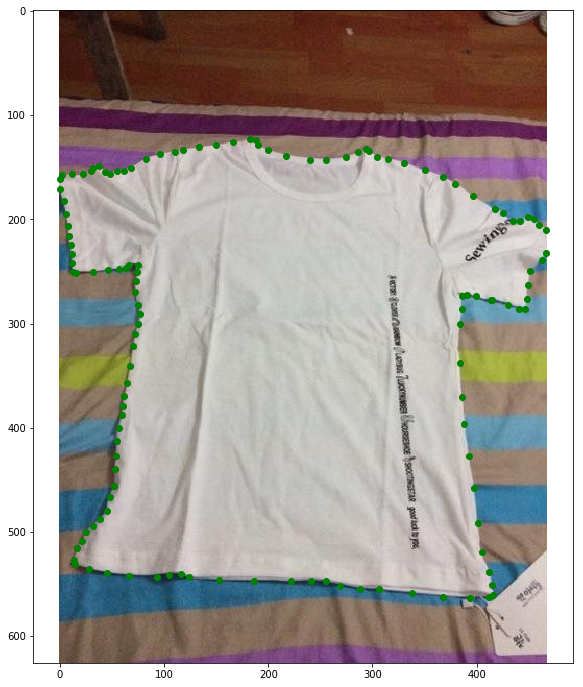

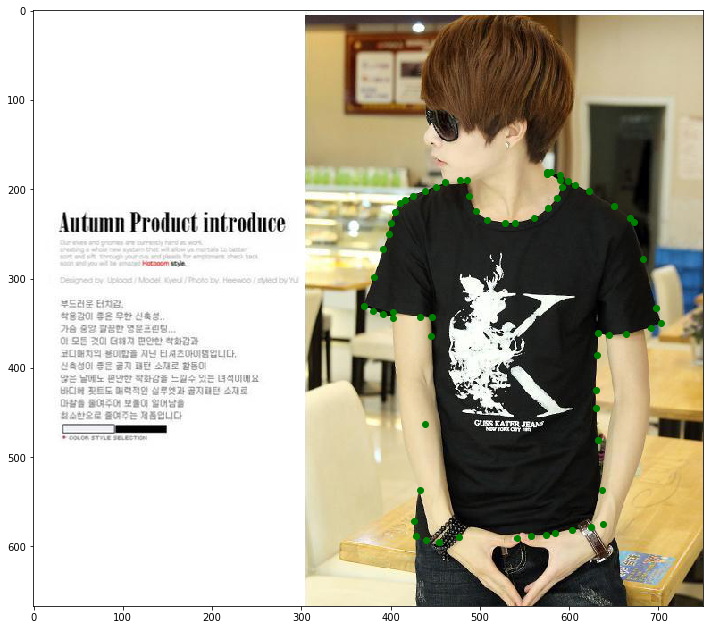

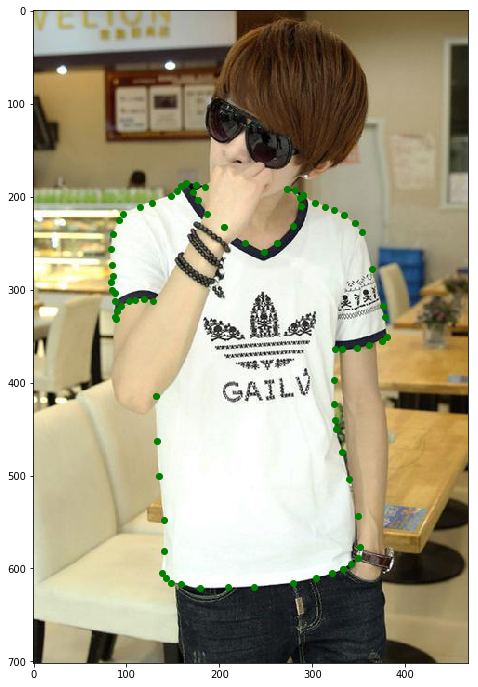

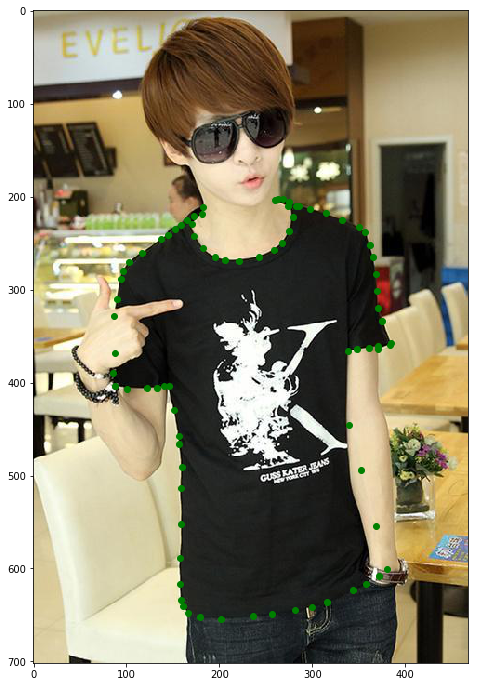

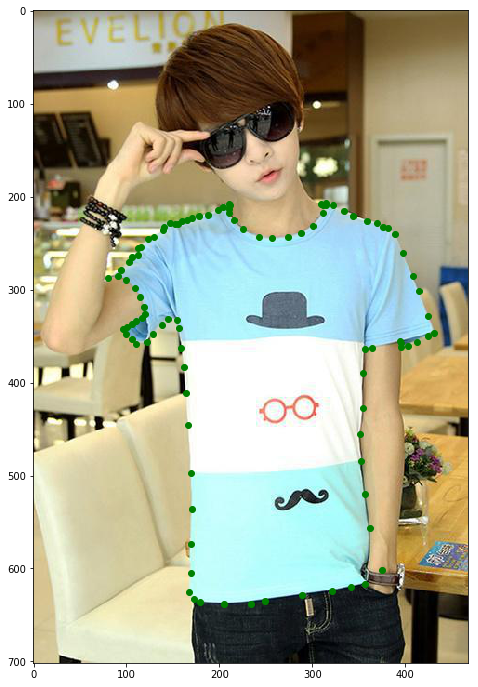

...

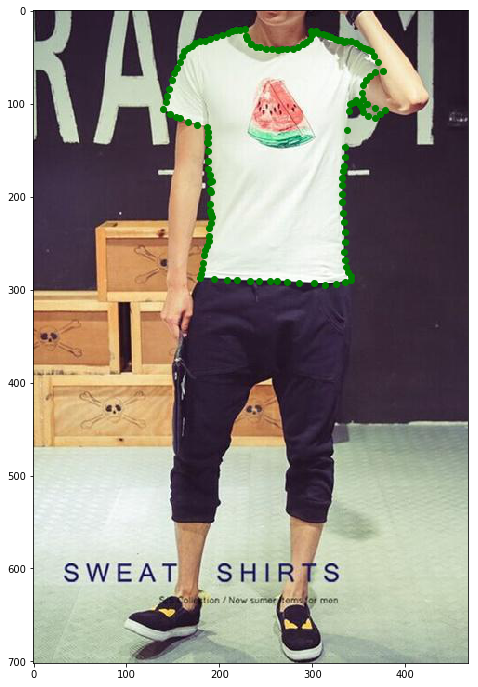

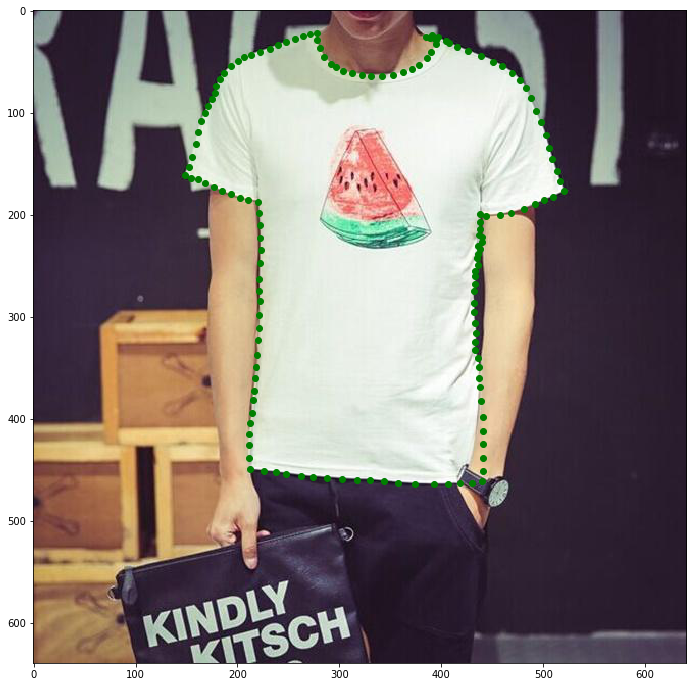

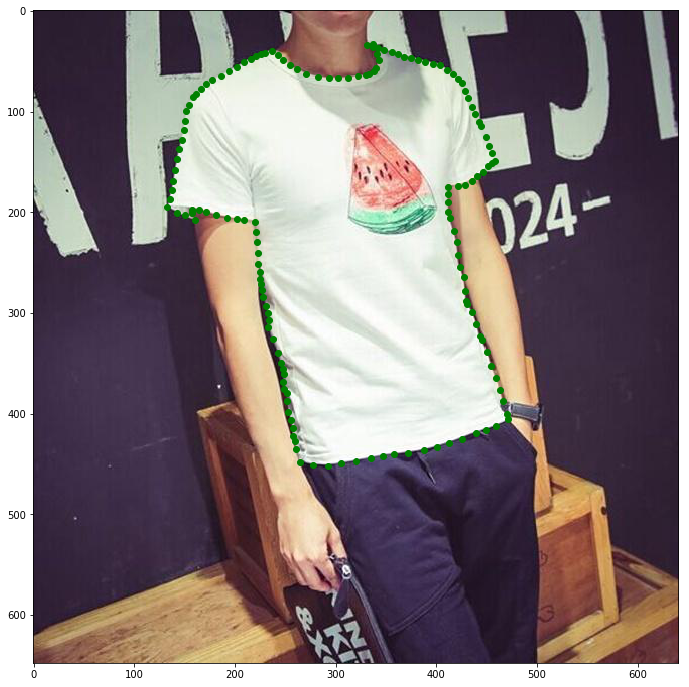

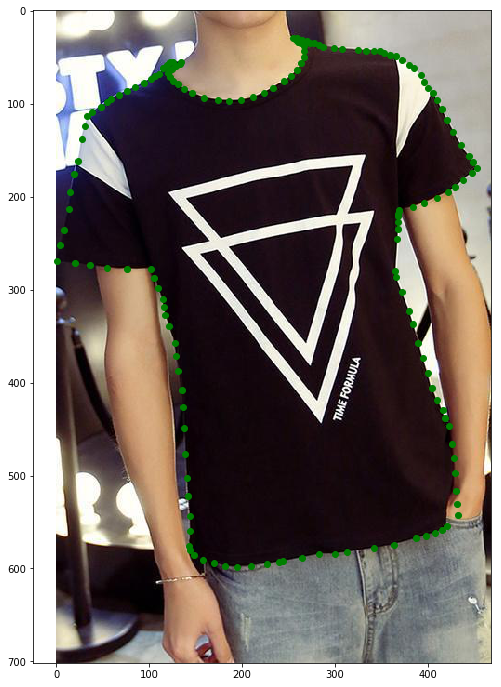

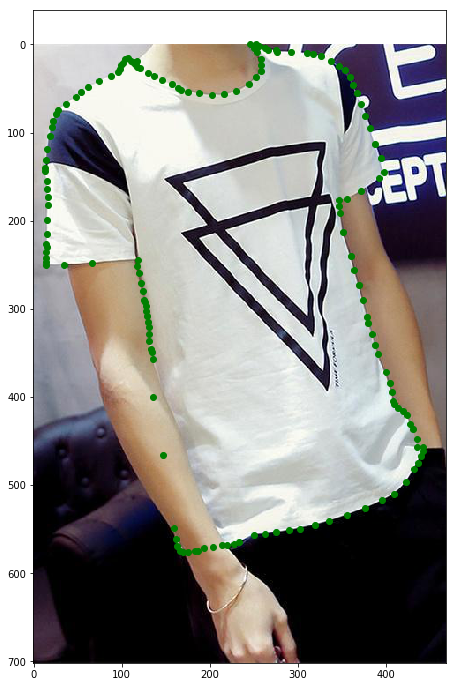

In [ ]:
for i in range(len(img_name)):
    # json 파일 열기
    with open(json_dir+json_name[i]) as json_file:
        json_data = json.load(json_file)
        
    # segmentation 좌표
    segmentation = json_data["item1"]["segmentation"][0]
    hl = len(segmentation)//2
    x = [segmentation[x*2] for x in range(hl)]
    y = [segmentation[x*2+1] for x in range(hl)]

    img = mpimg.imread(im_dir+img_name[i])
    # change the figure size
    fig2 = plt.figure(figsize = (12,12)) # create a 12 x 12 figure 
    ax3 = fig2.add_subplot(111)
    ax3.imshow(img, interpolation='none')
    plt.scatter(x, y,
               marker = 'o',
              color = 'green')

    plt.show()